In [1]:
#importing labraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
#read dataset
df= pd.read_csv("C:\\Users\\MANSI\\Downloads\\Product_details.csv")
df

,Text_ID,Product_Description,Product_Type,Sentiment
0,3057,The Web DesignerÛªs Guide to iOS (and Android...,9,2
1,6254,RT @mention Line for iPad 2 is longer today th...,9,2
2,8212,Crazy that Apple is opening a temporary store ...,9,2
3,4422,The lesson from Google One Pass: In this digit...,9,2
4,5526,RT @mention At the panel: &quot;Your mom has a...,9,2
...,...,...,...,...
6359,2945,Thanks @mention for hosting this event #sxsw #...,9,2
6360,4528,"SXSW iPhone app is awesome, but iPad app crash...",7,1
6361,6526,RT @mention RT @mention Download 20+ free trac...,9,2
6362,2110,OH at Texas Social Media Awards: 'You don't ne...,9,2


In [3]:
df['Product_Type'].value_counts()

9    4070
6     665
2     465
7     327
3     300
5     213
8     194
1      59
0      52
4      19
Name: Product_Type, dtype: int64

In [4]:
df['Sentiment'].value_counts()

2    3765
3    2089
1     399
0     111
Name: Sentiment, dtype: int64

# Pre-Processing
1.Expanding Contraction
2.Language Detection
3.Tokenization
4.Converting all characters to lowercase
5.Removing Punctuation
6.Removing Stopwords
7.Lemmatization

In [5]:
#importing requied labraries
import nltk
!pip install contractions
import contractions
import string
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords , wordnet
from nltk.stem import WordNetLemmatizer
pd.set_option('display.max_colwidth',100)

In [6]:
# drop Text_ID column
df=df.drop('Text_ID',axis=1)

In [7]:
df

,Product_Description,Product_Type,Sentiment
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2
...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2
6362,OH at Texas Social Media Awards: 'You don't need to ask your mother anymore. Just Google it.' #s...,9,2


In [8]:
df.columns

Index(['Product_Description', 'Product_Type', 'Sentiment'], dtype='object')

In [9]:
# checking for null values
for col in df.columns:
    print(col,df[col].isnull().sum())

Product_Description 0
Product_Type 0
Sentiment 0


In [10]:
#Expanding Contractions
df['no_contract']=df['Product_Description'].apply(lambda x: [contractions.fix(word) for word in x.split()])
df

,Product_Description,Product_Type,Sentiment,no_contract
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link..."
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get..."
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra..."
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ..."
...,...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2,"[Thanks, @mention, for, hosting, this, event, #sxsw, #sxswi, #iwantacr48, {link}]"
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1,"[SXSW, iPhone, app, is, awesome,, but, iPad, app, crashes, every, time., #sxsw]"
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2,"[RT, @mention, RT, @mention, Download, 20+, free, tracks, from, @mention, Music, Sampler, @menti..."
6362,OH at Texas Social Media Awards: 'You don't need to ask your mother anymore. Just Google it.' #s...,9,2,"[OH, at, Texas, Social, Media, Awards:, 'You, do not, need, to, ask, your, mother, anymore., Jus..."


In [11]:
df.dtypes

Product_Description    object
Product_Type            int64
Sentiment               int64
no_contract            object
dtype: object

In [12]:
#converting back to string
df['Product_Description_str']=[' '.join(map(str,l)) for l in df['no_contract']]
df

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw"
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw"
...,...,...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2,"[Thanks, @mention, for, hosting, this, event, #sxsw, #sxswi, #iwantacr48, {link}]",Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link}
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1,"[SXSW, iPhone, app, is, awesome,, but, iPad, app, crashes, every, time., #sxsw]","SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw"
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2,"[RT, @mention, RT, @mention, Download, 20+, free, tracks, from, @mention, Music, Sampler, @menti...",RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...
6362,OH at Texas Social Media Awards: 'You don't need to ask your mother anymore. Just Google it.' #s...,9,2,"[OH, at, Texas, Social, Media, Awards:, 'You, do not, need, to, ask, your, mother, anymore., Jus...",OH at Texas Social Media Awards: 'You do not need to ask your mother anymore. Just Google it.' #...


In [13]:
#English Language Detection
!pip install langdetect

In [14]:
from langdetect import detect

for sent in df['Product_Description_str']:
     df['lang']=detect(sent)
        
df

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en
...,...,...,...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2,"[Thanks, @mention, for, hosting, this, event, #sxsw, #sxswi, #iwantacr48, {link}]",Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},en
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1,"[SXSW, iPhone, app, is, awesome,, but, iPad, app, crashes, every, time., #sxsw]","SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",en
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2,"[RT, @mention, RT, @mention, Download, 20+, free, tracks, from, @mention, Music, Sampler, @menti...",RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,en
6362,OH at Texas Social Media Awards: 'You don't need to ask your mother anymore. Just Google it.' #s...,9,2,"[OH, at, Texas, Social, Media, Awards:, 'You, do not, need, to, ask, your, mother, anymore., Jus...",OH at Texas Social Media Awards: 'You do not need to ask your mother anymore. Just Google it.' #...,en


In [15]:
df['lang'].value_counts()

en    6364
Name: lang, dtype: int64

In [16]:
df['tokenized']=df['Product_Description_str'].apply(word_tokenize)
df

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m..."
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo..."
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra..."
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, mention, At, the, panel, :, &, quot, ;, Your, mom, has, an, ipad, ,, designing, for, boo..."
...,...,...,...,...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2,"[Thanks, @mention, for, hosting, this, event, #sxsw, #sxswi, #iwantacr48, {link}]",Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},en,"[Thanks, @, mention, for, hosting, this, event, #, sxsw, #, sxswi, #, iwantacr48, {, link, }]"
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1,"[SXSW, iPhone, app, is, awesome,, but, iPad, app, crashes, every, time., #sxsw]","SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",en,"[SXSW, iPhone, app, is, awesome, ,, but, iPad, app, crashes, every, time, ., #, sxsw]"
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2,"[RT, @mention, RT, @mention, Download, 20+, free, tracks, from, @mention, Music, Sampler, @menti...",RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,en,"[RT, @, mention, RT, @, mention, Download, 20+, free, tracks, from, @, mention, Music, Sampler, ..."
6362,OH at Texas Social Media Awards: 'You don't need to ask your mother anymore. Just Google it.' #s...,9,2,"[OH, at, Texas, Social, Media, Awards:, 'You, do not, need, to, ask, your, mother, anymore., Jus...",OH at Texas Social Media Awards: 'You do not need to ask your mother anymore. Just Google it.' #...,en,"[OH, at, Texas, Social, Media, Awards, :, 'You, do, not, need, to, ask, your, mother, anymore, ...."


In [17]:
#Converting all the characters to Lowercase
df['lower']=df['tokenized'].apply(lambda x:[word.lower() for word in x])
df

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized,lower
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, (, and, android, ), apps, ,, today, @, mention, 10, a.m..."
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo...","[rt, @, mention, line, for, ipad, 2, is, longer, today, than, yesterday, ., #, sxsw, //, are, yo..."
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra..."
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, :, in, this, digital, environment, ,, users, want, to, pu..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, mention, At, the, panel, :, &, quot, ;, Your, mom, has, an, ipad, ,, designing, for, boo...","[rt, @, mention, at, the, panel, :, &, quot, ;, your, mom, has, an, ipad, ,, designing, for, boo..."
...,...,...,...,...,...,...,...,...
6359,Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},9,2,"[Thanks, @mention, for, hosting, this, event, #sxsw, #sxswi, #iwantacr48, {link}]",Thanks @mention for hosting this event #sxsw #sxswi #iwantacr48 {link},en,"[Thanks, @, mention, for, hosting, this, event, #, sxsw, #, sxswi, #, iwantacr48, {, link, }]","[thanks, @, mention, for, hosting, this, event, #, sxsw, #, sxswi, #, iwantacr48, {, link, }]"
6360,"SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",7,1,"[SXSW, iPhone, app, is, awesome,, but, iPad, app, crashes, every, time., #sxsw]","SXSW iPhone app is awesome, but iPad app crashes every time. #sxsw",en,"[SXSW, iPhone, app, is, awesome, ,, but, iPad, app, crashes, every, time, ., #, sxsw]","[sxsw, iphone, app, is, awesome, ,, but, ipad, app, crashes, every, time, ., #, sxsw]"
6361,RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,9,2,"[RT, @mention, RT, @mention, Download, 20+, free, tracks, from, @mention, Music, Sampler, @menti...",RT @mention RT @mention Download 20+ free tracks from @mention Music Sampler @mention including ...,en,"[RT, @, mention, RT, @, mention, Download, 20+, free, tracks, from, @, mention, Music, Sampler, ...","[rt, @, mention, rt, @, mention, download, 20+, free, tracks, from

In [18]:
#Removing Punctutions
punc= string.punctuation
df['no_punc']=df['lower'].apply(lambda x: [word for word in x if word not in punc])
df.head()

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized,lower,no_punc
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, (, and, android, ), apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, and, android, apps, today, mention, 10, a.m, link, sxsw]"
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo...","[rt, @, mention, line, for, ipad, 2, is, longer, today, than, yesterday, ., #, sxsw, //, are, yo...","[rt, mention, line, for, ipad, 2, is, longer, today, than, yesterday, sxsw, //, are, you, gettin..."
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra..."
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, :, in, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, in, this, digital, environment, users, want, to, purchase..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, mention, At, the, panel, :, &, quot, ;, Your, mom, has, an, ipad, ,, designing, for, boo...","[rt, @, mention, at, the, panel, :, &, quot, ;, your, mom, has, an, ipad, ,, designing, for, boo...","[rt, mention, at, the, panel, quot, your, mom, has, an, ipad, designing, for, boomers, quot, sxsw]"


In [19]:
#Removing Stopwords
stop_words=set(stopwords.words('english'))
df['no_stopword']=df['no_punc'].apply(lambda x: [word for word in x if word not in stop_words])
df.head()

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized,lower,no_punc,no_stopword
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, (, and, android, ), apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, and, android, apps, today, mention, 10, a.m, link, sxsw]","[web, designerûªs, guide, ios, android, apps, today, mention, 10, a.m, link, sxsw]"
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo...","[rt, @, mention, line, for, ipad, 2, is, longer, today, than, yesterday, ., #, sxsw, //, are, yo...","[rt, mention, line, for, ipad, 2, is, longer, today, than, yesterday, sxsw, //, are, you, gettin...","[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]"
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seekers]"
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, :, in, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, in, this, digital, environment, users, want, to, purchase...","[lesson, google, one, pass, digital, environment, users, want, purchase, across, every, platform..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, mention, At, the, panel, :, &, quot, ;, Your, mom, has, an, ipad, ,, designing, for, boo...","[rt, @, mention, at, the, panel, :, &, quot, ;, your, mom, has, an, ipad, ,, designing, for, boo...","[rt, mention, at, the, panel, quot, your, mom, has, an, ipad, designing, for, boomers, quot, sxsw]","[rt, mention, panel, quot, mom, ipad, designing, boomers, quot, sxsw]"


In [20]:
#Lemmatization
import nltk
nltk.download('omw-1.4')
wnl=WordNetLemmatizer()
df['lemmatized']=df['no_stopword'].apply(lambda x:[wnl.lemmatize(word) for word in x])
df

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\MANSI\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized,lower,no_punc,no_stopword,lemmatized
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, (, and, android, ), apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, and, android, apps, today, mention, 10, a.m, link, sxsw]","[web, designerûªs, guide, ios, android, apps, today, mention, 10, a.m, link, sxsw]","[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]"
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo...","[rt, @, mention, line, for, ipad, 2, is, longer, today, than, yesterday, ., #, sxsw, //, are, yo...","[rt, mention, line, for, ipad, 2, is, longer, today, than, yesterday, sxsw, //, are, you, gettin...","[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]","[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]"
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seekers]","[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]"
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, :, in, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, in, this, digital, environment, users, want, to, purchase...","[lesson, google, one, pass, digital, environment, users, want, purchase, across, every, platform...","[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ..."
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, mention, At, the, panel, :, &, quot, ;, Your, mom, has, an, ipad, ,, designing, for, boo...","[rt, @, mention, at, the, panel, :, &, quot, ;, your, mom, has, an, ipad, ,, designing, for, boo...","[rt, mention, at, the, panel, quot, your, mom, has, an, ipad, designing, for, boomers, quot, sxsw]","[rt, mention, panel, quot, mom, ipad, designing, boo

# EDA(Exploratory Data Analysis)

In [21]:
#!pip install pyLDAvis
import pyLDAvis.sklearn
from collections import Counter
from textblob import TextBlob
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation, NMF 
from wordcloud import WordCloud, ImageColorGenerator

In [22]:
#converting back to string
df['lemmatized_str']=[' '.join(map(str,l)) for l in df['lemmatized']]
df

,Product_Description,Product_Type,Sentiment,no_contract,Product_Description_str,lang,tokenized,lower,no_punc,no_stopword,lemmatized,lemmatized_str
0,"The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",9,2,"[The, Web, DesignerÛªs, Guide, to, iOS, (and, Android), Apps,, today, @mention, 10, a.m!, {link...","The Web DesignerÛªs Guide to iOS (and Android) Apps, today @mention 10 a.m! {link} #sxsw",en,"[The, Web, DesignerÛªs, Guide, to, iOS, (, and, Android, ), Apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, (, and, android, ), apps, ,, today, @, mention, 10, a.m...","[the, web, designerûªs, guide, to, ios, and, android, apps, today, mention, 10, a.m, link, sxsw]","[web, designerûªs, guide, ios, android, apps, today, mention, 10, a.m, link, sxsw]","[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]",web designerûªs guide io android apps today mention 10 a.m link sxsw
1,RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line ag...,9,2,"[RT, @mention, Line, for, iPad, 2, is, longer, today, than, yesterday., #SXSW, //, are, you, get...",RT @mention Line for iPad 2 is longer today than yesterday. #SXSW // are you getting in line aga...,en,"[RT, @, mention, Line, for, iPad, 2, is, longer, today, than, yesterday, ., #, SXSW, //, are, yo...","[rt, @, mention, line, for, ipad, 2, is, longer, today, than, yesterday, ., #, sxsw, //, are, yo...","[rt, mention, line, for, ipad, 2, is, longer, today, than, yesterday, sxsw, //, are, you, gettin...","[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]","[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]",rt mention line ipad 2 longer today yesterday sxsw // getting line today fun
2,Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,9,2,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...",Crazy that Apple is opening a temporary store in Austin tomorrow to handle the rabid #sxsw eye p...,en,"[Crazy, that, Apple, is, opening, a, temporary, store, in, Austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, that, apple, is, opening, a, temporary, store, in, austin, tomorrow, to, handle, the, ra...","[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seekers]","[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]",crazy apple opening temporary store austin tomorrow handle rabid sxsw eye pad seeker
3,"The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",9,2,"[The, lesson, from, Google, One, Pass:, In, this, digital, environment,, users, want, to, purcha...","The lesson from Google One Pass: In this digital environment, users want to purchase across ever...",en,"[The, lesson, from, Google, One, Pass, :, In, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, :, in, this, digital, environment, ,, users, want, to, pu...","[the, lesson, from, google, one, pass, in, this, digital, environment, users, want, to, purchase...","[lesson, google, one, pass, digital, environment, users, want, purchase, across, every, platform...","[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ...",lesson google one pas digital environment user want purchase across every platform one tool sxsw...
4,"RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",9,2,"[RT, @mention, At, the, panel:, &quot;Your, mom, has, an, ipad,, designing, for, boomers&quot;, ...","RT @mention At the panel: &quot;Your mom has an ipad, designing for boomers&quot; #sxsw",en,"[RT, @, me

In [23]:
df1=df[['Product_Type','Sentiment','lemmatized_str','lemmatized']]
df1

,Product_Type,Sentiment,lemmatized_str,lemmatized
0,9,2,web designerûªs guide io android apps today mention 10 a.m link sxsw,"[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]"
1,9,2,rt mention line ipad 2 longer today yesterday sxsw // getting line today fun,"[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]"
2,9,2,crazy apple opening temporary store austin tomorrow handle rabid sxsw eye pad seeker,"[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]"
3,9,2,lesson google one pas digital environment user want purchase across every platform one tool sxsw...,"[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ..."
4,9,2,rt mention panel quot mom ipad designing boomer quot sxsw,"[rt, mention, panel, quot, mom, ipad, designing, boomer, quot, sxsw]"
...,...,...,...,...
6359,9,2,thanks mention hosting event sxsw sxswi iwantacr48 link,"[thanks, mention, hosting, event, sxsw, sxswi, iwantacr48, link]"
6360,7,1,sxsw iphone app awesome ipad app crash every time sxsw,"[sxsw, iphone, app, awesome, ipad, app, crash, every, time, sxsw]"
6361,9,2,rt mention rt mention download 20+ free track mention music sampler mention including glove link...,"[rt, mention, rt, mention, download, 20+, free, track, mention, music, sampler, mention, includi..."
6362,9,2,oh texas social medium award 'you need ask mother anymore google sxswi sxsw,"[oh, texas, social, medium, award, 'you, need, ask, mother, anymore, google, sxswi, sxsw]"


In [24]:
#sentiment polarity analysis
df1['sentiment_polarity']=df1['lemmatized_str'].apply(lambda x: TextBlob(x).sentiment.polarity)
df1.head(20)

C:\Users\MANSI\AppData\Local\Temp\ipykernel_7484\1025018308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['sentiment_polarity']=df1['lemmatized_str'].apply(lambda x: TextBlob(x).sentiment.polarity)


,Product_Type,Sentiment,lemmatized_str,lemmatized,sentiment_polarity
0,9,2,web designerûªs guide io android apps today mention 10 a.m link sxsw,"[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]",0.000000
1,9,2,rt mention line ipad 2 longer today yesterday sxsw // getting line today fun,"[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]",0.300000
2,9,2,crazy apple opening temporary store austin tomorrow handle rabid sxsw eye pad seeker,"[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]",-0.600000
3,9,2,lesson google one pas digital environment user want purchase across every platform one tool sxsw...,"[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ...",0.000000
4,9,2,rt mention panel quot mom ipad designing boomer quot sxsw,"[rt, mention, panel, quot, mom, ipad, designing, boomer, quot, sxsw]",0.000000
5,6,1,rt mention think effing hubby line ipad 2 someone point towards line-up wife number 2 sxswi sxsw,"[rt, mention, think, effing, hubby, line, ipad, 2, someone, point, towards, line-up, wife, numbe...",-0.500000
6,9,2,quot android user iphone user use option menu contextual menu quot mention sxsw,"[quot, android, user, iphone, user, use, option, menu, contextual, menu, quot, mention, sxsw]",0.000000
7,9,3,wow rt mention interrupt regularly scheduled sxsw geek programming big news link google circle,"[wow, rt, mention, interrupt, regularly, scheduled, sxsw, geek, programming, big, news, link, go...",0.033333
8,9,2,google launch new social network called circle possibly today link link sxsw,"[google, launch, new, social, network, called, circle, possibly, today, link, link, sxsw]",0.056566
9,9,2,mention welcome enjoy sxsw ride anywhere austin 10 dwnld groundlink app link booth 437,"[mention, welcome, enjoy, sxsw, ride, anywhere, austin, 10, dwnld, groundlink, app, link, booth,...",0.600000


In [25]:
pd.set_option('display.max_row',None)

In [26]:
df1['sentiment_polarity'].groupby(df1['Sentiment']).value_counts()

Sentiment  sentiment_polarity
0           0.000000e+00           50
            2.500000e-01            4
           -5.000000e-01            3
            2.000000e-01            3
            8.000000e-01            3
           -4.000000e-01            2
           -1.000000e-01            2
            5.075758e-02            2
            1.000000e-01            2
            3.000000e-01            2
            4.000000e-01            2
            5.000000e-01            2
           -1.000000e+00            1
           -3.666667e-01            1
           -3.250000e-01            1
           -3.125000e-01            1
           -3.000000e-01            1
           -2.500000e-01            1
           -1.250000e-01            1
           -7.142857e-02            1
           -5.000000e-02            1
           -5.000000e-02            1
            1.666667e-02            1
            3.068182e-02            1
            3.333333e-02            1
            9.583333

observation:-Each Sentiment has both Positive and Negative Polarity

In [27]:
df1['sentiment_polarity'].groupby(df1['Product_Type']).value_counts()

Product_Type  sentiment_polarity
0              0.000000e+00           13
               5.000000e-01            4
               1.363636e-01            3
               3.500000e-01            3
               2.000000e-01            2
               1.000000e+00            2
              -8.000000e-01            1
              -4.000000e-01            1
              -2.500000e-01            1
              -1.875000e-01            1
              -6.250000e-02            1
              -5.000000e-02            1
               1.944444e-02            1
               2.500000e-02            1
               1.190476e-01            1
               1.500000e-01            1
               2.142857e-01            1
               2.500000e-01            1
               2.666667e-01            1
               2.681818e-01            1
               3.250000e-01            1
               3.750000e-01            1
               4.000000e-01            1
               4.000000e

Only product 4 has positive sentiment polarity

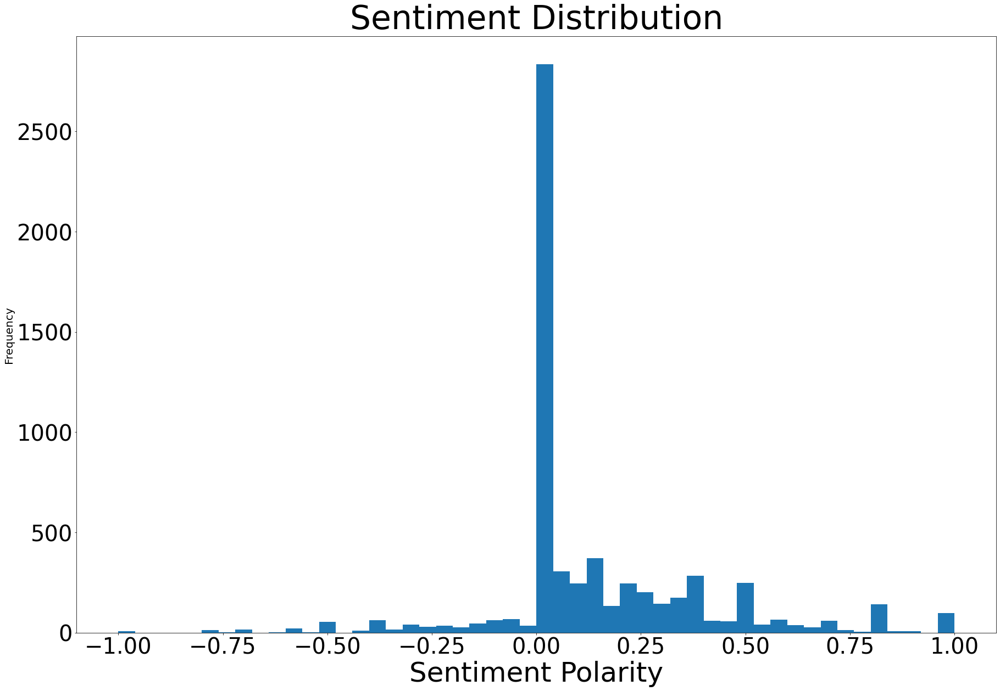

In [28]:
#for the sentiment polarity we will plot a histogram and observe the distribution.
plt.figure(figsize=(30,20))
plt.xlabel('Sentiment Polarity',fontsize=50)
plt.xticks(fontsize=40)
plt.ylabel('Frequency',fontsize=20)
plt.yticks(fontsize=40)
plt.hist(df1['sentiment_polarity'],bins=50)
plt.title('Sentiment Distribution',fontsize=60)
plt.show()

Most of the Distribution lies on right side of 0.00 (i.e,Positive).So,overall we can conclude that the customers are happy with products

C:\Users\MANSI\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


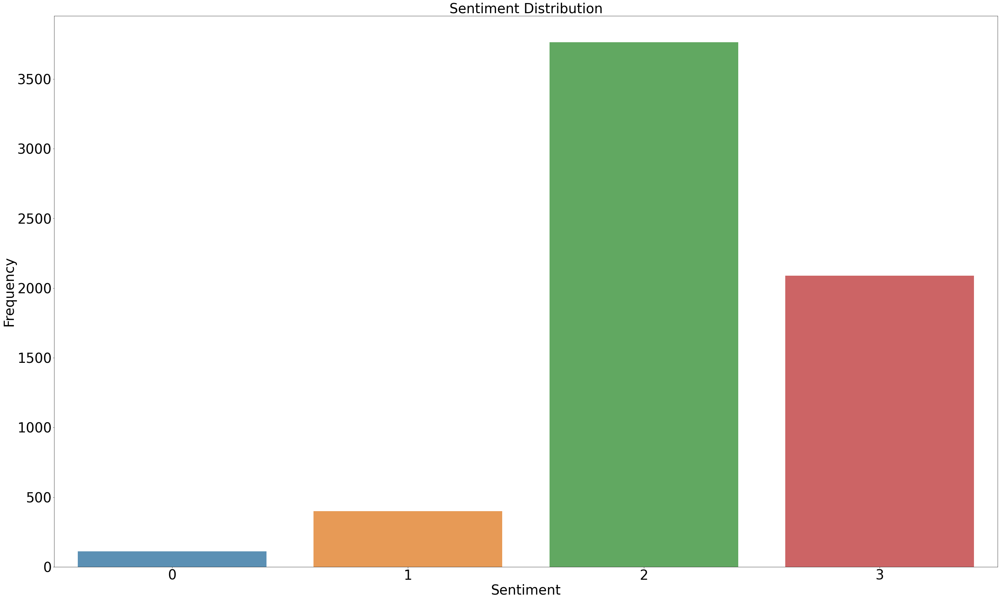

In [29]:
x=df1.Sentiment.value_counts()
y=x.sort_index()
plt.figure(figsize=(50,30))
sns.barplot(x.index,x.values,alpha=0.8)
plt.title("Sentiment Distribution",fontsize=40)
plt.ylabel('Frequency',fontsize=40)
plt.yticks(fontsize=40)
plt.xlabel('Sentiment',fontsize=40)
plt.xticks(fontsize=40)
plt.show()

In [30]:
df1[df1['Sentiment']==2]

,Product_Type,Sentiment,lemmatized_str,lemmatized,sentiment_polarity
0,9,2,web designerûªs guide io android apps today mention 10 a.m link sxsw,"[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]",0.000000e+00
1,9,2,rt mention line ipad 2 longer today yesterday sxsw // getting line today fun,"[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]",3.000000e-01
2,9,2,crazy apple opening temporary store austin tomorrow handle rabid sxsw eye pad seeker,"[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]",-6.000000e-01
3,9,2,lesson google one pas digital environment user want purchase across every platform one tool sxsw...,"[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ...",0.000000e+00
4,9,2,rt mention panel quot mom ipad designing boomer quot sxsw,"[rt, mention, panel, quot, mom, ipad, designing, boomer, quot, sxsw]",0.000000e+00
6,9,2,quot android user iphone user use option menu contextual menu quot mention sxsw,"[quot, android, user, iphone, user, use, option, menu, contextual, menu, quot, mention, sxsw]",0.000000e+00
8,9,2,google launch new social network called circle possibly today link link sxsw,"[google, launch, new, social, network, called, circle, possibly, today, link, link, sxsw]",5.656566e-02
9,9,2,mention welcome enjoy sxsw ride anywhere austin 10 dwnld groundlink app link booth 437,"[mention, welcome, enjoy, sxsw, ride, anywhere, austin, 10, dwnld, groundlink, app, link, booth,...",6.000000e-01
10,9,2,rt mention apple plan keep austin wired opening pop-up apple store sxsw link,"[rt, mention, apple, plan, keep, austin, wired, opening, pop-up, apple, store, sxsw, link]",0.000000e+00
12,9,2,know sxsw season 10 app update whenever open iphone app store,"[know, sxsw, season, 10, app, update, whenever, open, iphone, app, store]",0.000000e+00


<AxesSubplot:title={'center':'Percentage of Ratings'}, ylabel='Sentiment'>

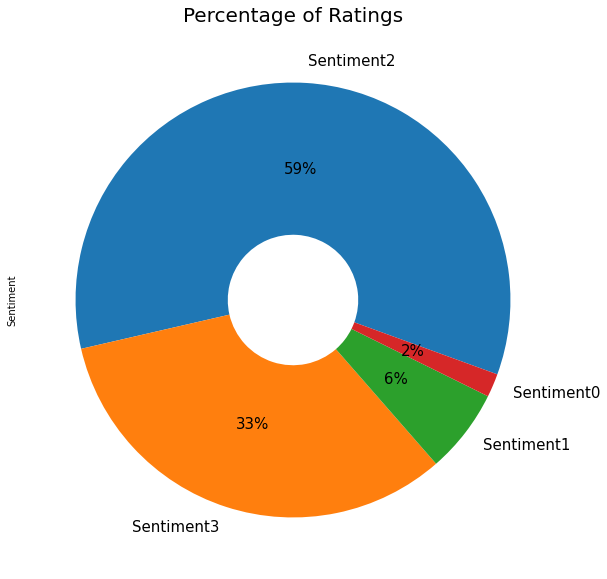

In [31]:
plt.figure(figsize=(30,10))
plt.title('Percentage of Ratings',fontsize=20)
df1.Sentiment.value_counts().plot(kind='pie',labels=['Sentiment2','Sentiment3','Sentiment1','Sentiment0'],
                                 wedgeprops=dict(width=.7),autopct='%1.0f%%',startangle=-20,
                                 textprops={'fontsize':15})

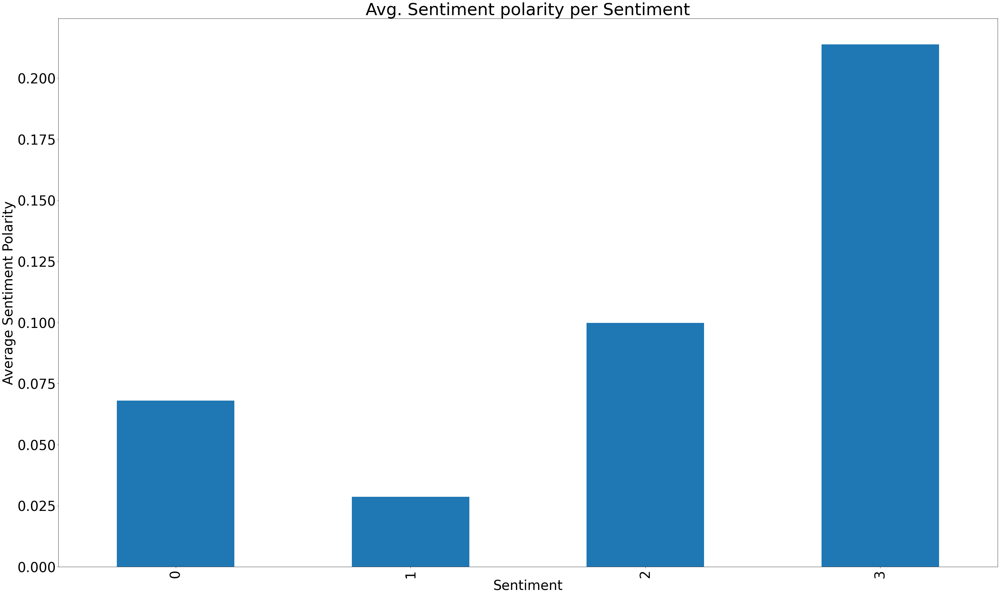

In [32]:
df1.groupby('Sentiment')['sentiment_polarity'].mean().plot(kind='bar',figsize=(50,30))
plt.xlabel("Sentiment",fontsize=40)
plt.ylabel("Average Sentiment Polarity",fontsize=40)
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.title('Avg. Sentiment polarity per Sentiment',fontsize=50)
plt.show()

In [33]:
df1['word_count']=df1['lemmatized'].apply(lambda x: len(str(x).split()))

C:\Users\MANSI\AppData\Local\Temp\ipykernel_7484\317570549.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['word_count']=df1['lemmatized'].apply(lambda x: len(str(x).split()))


In [34]:
df1

,Product_Type,Sentiment,lemmatized_str,lemmatized,sentiment_polarity,word_count
0,9,2,web designerûªs guide io android apps today mention 10 a.m link sxsw,"[web, designerûªs, guide, io, android, apps, today, mention, 10, a.m, link, sxsw]",0.000000e+00,12
1,9,2,rt mention line ipad 2 longer today yesterday sxsw // getting line today fun,"[rt, mention, line, ipad, 2, longer, today, yesterday, sxsw, //, getting, line, today, fun]",3.000000e-01,14
2,9,2,crazy apple opening temporary store austin tomorrow handle rabid sxsw eye pad seeker,"[crazy, apple, opening, temporary, store, austin, tomorrow, handle, rabid, sxsw, eye, pad, seeker]",-6.000000e-01,13
3,9,2,lesson google one pas digital environment user want purchase across every platform one tool sxsw...,"[lesson, google, one, pas, digital, environment, user, want, purchase, across, every, platform, ...",0.000000e+00,16
4,9,2,rt mention panel quot mom ipad designing boomer quot sxsw,"[rt, mention, panel, quot, mom, ipad, designing, boomer, quot, sxsw]",0.000000e+00,10
5,6,1,rt mention think effing hubby line ipad 2 someone point towards line-up wife number 2 sxswi sxsw,"[rt, mention, think, effing, hubby, line, ipad, 2, someone, point, towards, line-up, wife, numbe...",-5.000000e-01,17
6,9,2,quot android user iphone user use option menu contextual menu quot mention sxsw,"[quot, android, user, iphone, user, use, option, menu, contextual, menu, quot, mention, sxsw]",0.000000e+00,13
7,9,3,wow rt mention interrupt regularly scheduled sxsw geek programming big news link google circle,"[wow, rt, mention, interrupt, regularly, scheduled, sxsw, geek, programming, big, news, link, go...",3.333333e-02,14
8,9,2,google launch new social network called circle possibly today link link sxsw,"[google, launch, new, social, network, called, circle, possibly, today, link, link, sxsw]",5.656566e-02,12
9,9,2,mention welcome enjoy sxsw ride anywhere austin 10 dwnld groundlink app link booth 437,"[mention, welcome, enjoy, sxsw, ride, anywhere, austin, 10, dwnld, groundlink, app, link, booth,...",6.000000e-01,14


In [35]:
df1['word_count'].value_counts()

13    695
12    675
14    675
15    614
11    568
16    512
10    490
9     402
8     393
17    330
7     272
18    243
6     147
19    127
5      81
20     62
21     30
4      18
22     17
3       4
23      3
24      2
25      1
2       1
27      1
26      1
Name: word_count, dtype: int64

Let's observe that the longest review is for negative or neutral.this can be done by finding correlation matrix.

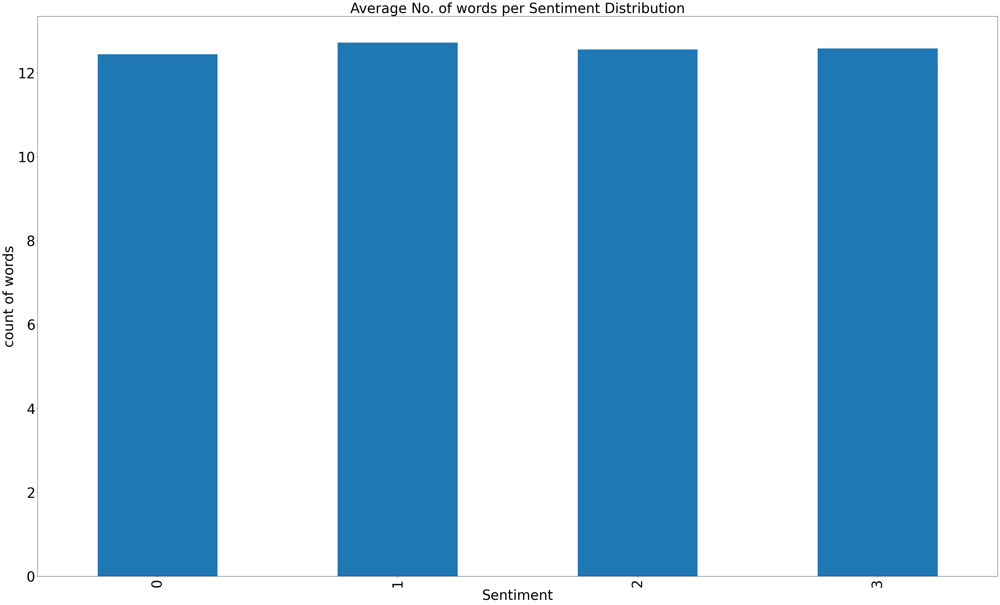

In [36]:
df1.groupby('Sentiment')['word_count'].mean().plot(kind='bar',figsize=(50,30))
plt.xlabel('Sentiment',fontsize=40)
plt.ylabel('count of words',fontsize=40)
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
plt.title('Average No. of words per Sentiment Distribution',fontsize=40)
plt.show()

Sentiment 1 contains longest reviews

In [37]:
df1[df1['Sentiment']==1]

,Product_Type,Sentiment,lemmatized_str,lemmatized,sentiment_polarity,word_count
5,6,1,rt mention think effing hubby line ipad 2 someone point towards line-up wife number 2 sxswi sxsw,"[rt, mention, think, effing, hubby, line, ipad, 2, someone, point, towards, line-up, wife, numbe...",-0.500000,17
15,2,1,horrible repressed memory apple spinning beach ball coming back progressbar talk sxsw,"[horrible, repressed, memory, apple, spinning, beach, ball, coming, back, progressbar, talk, sxsw]",-0.500000,12
20,8,1,sxsw enchantment mention quot sell dream steve job say iphone 188 parts+at amp made people suici...,"[sxsw, enchantment, mention, quot, sell, dream, steve, job, say, iphone, 188, parts+at, amp, mad...",0.000000,17
31,8,1,austin getting full sxsw underway tell iphone intermittent brick crowded,"[austin, getting, full, sxsw, underway, tell, iphone, intermittent, brick, crowded]",0.350000,10
53,3,1,rt mention rt mention mention launch major new social network called circle possibly today link ...,"[rt, mention, rt, mention, mention, launch, major, new, social, network, called, circle, possibl...",0.086439,21
56,2,1,mention might need go apple today think quot quot quot x quot quot w quot key worn sxsw,"[mention, might, need, go, apple, today, think, quot, quot, quot, x, quot, quot, w, quot, key, w...",0.000000,18
66,2,1,pop-up apple store seems pop-up ipad2s sxsw,"[pop-up, apple, store, seems, pop-up, ipad2s, sxsw]",0.000000,7
91,8,1,def could use ipad sxsw today tweeting via iphone sorta pretty much suck,"[def, could, use, ipad, sxsw, today, tweeting, via, iphone, sorta, pretty, much, suck]",0.225000,13
109,9,1,think sxsw taken upon make clear gen 1 iphone going cut anymore,"[think, sxsw, taken, upon, make, clear, gen, 1, iphone, going, cut, anymore]",0.100000,12
115,3,1,google prefers launch hyped new social feature meh bang via tc link sxsw,"[google, prefers, launch, hyped, new, social, feature, meh, bang, via, tc, link, sxsw]",0.084848,13


C:\Users\MANSI\AppData\Local\Temp\ipykernel_7484\3356815018.py:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask=np.zeros_like(correlation,dtype=np.bool)


<AxesSubplot:>

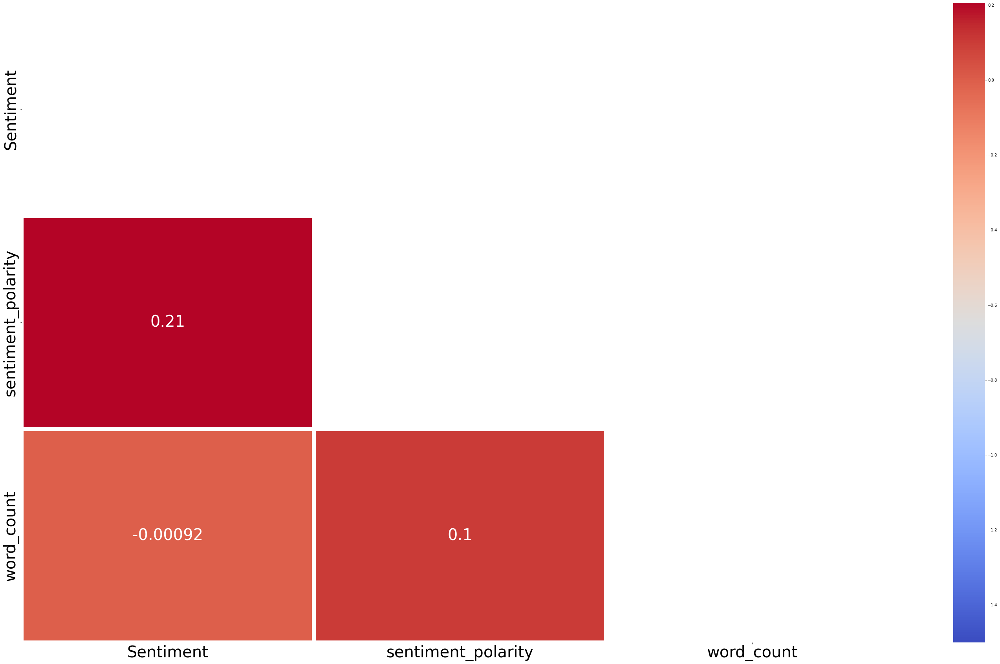

In [38]:
#correlation matrix
correlation=df1[['Sentiment','sentiment_polarity','word_count']].corr()
mask=np.zeros_like(correlation,dtype=np.bool)
mask[np.triu_indices_from(mask)]=True
plt.figure(figsize=(50,30))
plt.xticks(fontsize=40)
plt.yticks(fontsize=40)
sns.heatmap(correlation,cmap='coolwarm',annot=True,annot_kws={"size":40},linewidths=10,vmin=-1.5,mask=mask)

word_count and sentiment are negatively correlated

In [39]:
words= df1['lemmatized']
allwords=[]
for wordlist in words:
    allwords +=wordlist
    
print(len(allwords))    
print(allwords)


80010
['web', 'designer\x89ûªs', 'guide', 'io', 'android', 'apps', 'today', 'mention', '10', 'a.m', 'link', 'sxsw', 'rt', 'mention', 'line', 'ipad', '2', 'longer', 'today', 'yesterday', 'sxsw', '//', 'getting', 'line', 'today', 'fun', 'crazy', 'apple', 'opening', 'temporary', 'store', 'austin', 'tomorrow', 'handle', 'rabid', 'sxsw', 'eye', 'pad', 'seeker', 'lesson', 'google', 'one', 'pas', 'digital', 'environment', 'user', 'want', 'purchase', 'across', 'every', 'platform', 'one', 'tool', 'sxsw', 'elonsxsw', 'rt', 'mention', 'panel', 'quot', 'mom', 'ipad', 'designing', 'boomer', 'quot', 'sxsw', 'rt', 'mention', 'think', 'effing', 'hubby', 'line', 'ipad', '2', 'someone', 'point', 'towards', 'line-up', 'wife', 'number', '2', 'sxswi', 'sxsw', 'quot', 'android', 'user', 'iphone', 'user', 'use', 'option', 'menu', 'contextual', 'menu', 'quot', 'mention', 'sxsw', 'wow', 'rt', 'mention', 'interrupt', 'regularly', 'scheduled', 'sxsw', 'geek', 'programming', 'big', 'news', 'link', 'google', 'circ

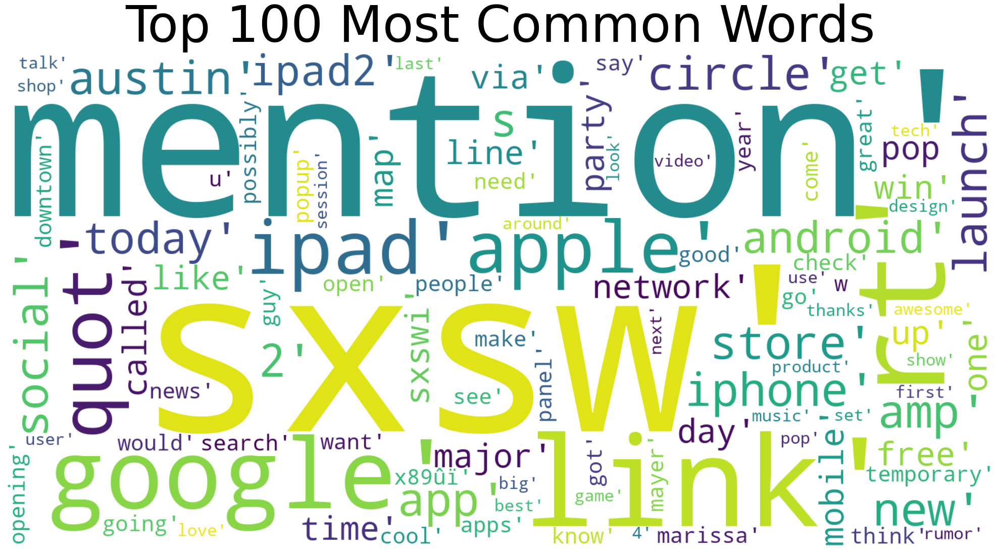

In [40]:
#wordcloud for top 100 most common words
mostcommon=FreqDist(allwords).most_common(100)

wordcloud=WordCloud(width=1600,height=800,background_color='white').generate(str(mostcommon))
fig=plt.figure(figsize=(40,15),facecolor='white')
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis('off')
plt.title('Top 100 Most Common Words',fontsize=100)

plt.tight_layout(pad=0)
plt.show()

this frequency analysis cenrtainly supports the overall positive sentiment of the reviews.
Terms such as good,love,awesome are showing that the customers are enjoying the products.


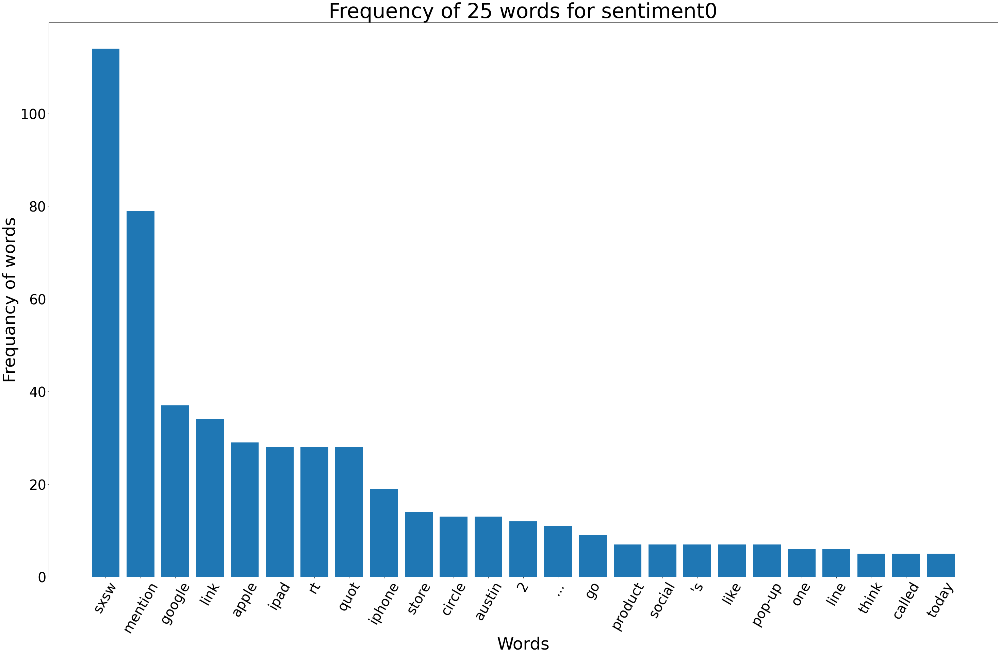

In [41]:
#most frequent words for sentiment0.
#while interpreting the result for sentiment0 we have to be careful as it contribute only 2%(as shown is pie chart above)
group_by=df1.groupby('Sentiment')['lemmatized_str'].apply(lambda x: Counter(' '.join(x).split()).most_common(25))

#for sentiment0
group_by_0=group_by.iloc[0]
word0=list(zip(*group_by_0))[0]
freq0=list(zip(*group_by_0))[1]

plt.figure(figsize=(50,30))
plt.bar(word0,freq0)
plt.xlabel('Words',fontsize=50)
plt.ylabel('Frequancy of words',fontsize=50)
plt.yticks(fontsize=40)
plt.xticks(rotation=60,fontsize=40)
plt.title('Frequency of 25 words for sentiment0',fontsize=60)
plt.show()

we can remove the words such as sxsw, mention,google,link as they accure very frequenly.Also it is very difficult to drive insights from neutral words.

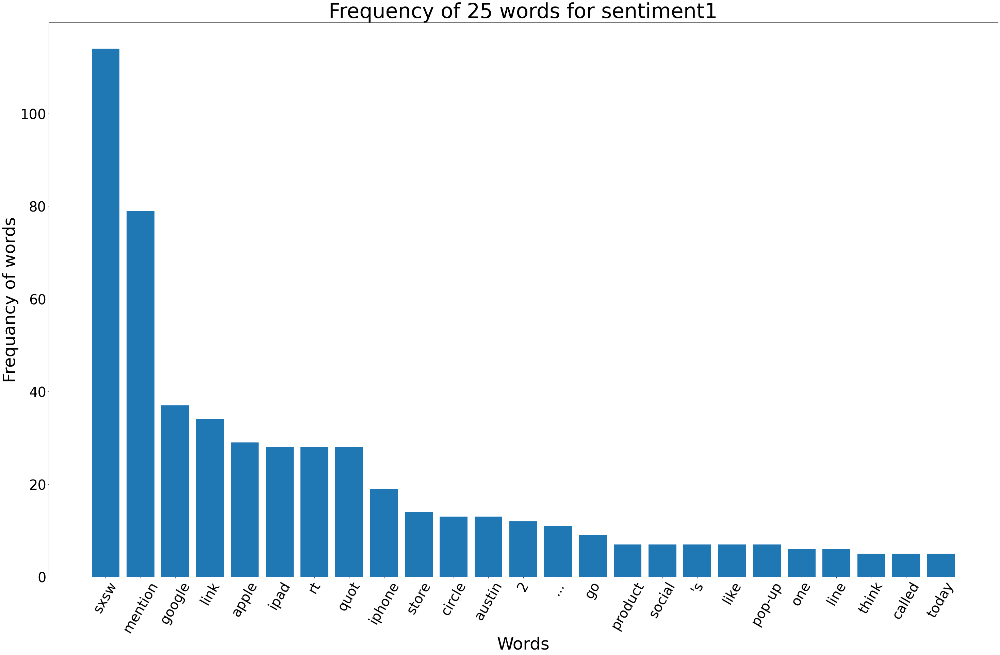

In [45]:
#for sentiment1
group_by_1=group_by.iloc[1]
word0=list(zip(*group_by_0))[0]
freq0=list(zip(*group_by_0))[1]

plt.figure(figsize=(50,30))
plt.bar(word0,freq0)
plt.xlabel('Words',fontsize=50)
plt.ylabel('Frequancy of words',fontsize=50)
plt.yticks(fontsize=40)
plt.xticks(rotation=60,fontsize=40)
plt.title('Frequency of 25 words for sentiment1',fontsize=60)
plt.show()

sentiment1 also don't have clues for product improvement.

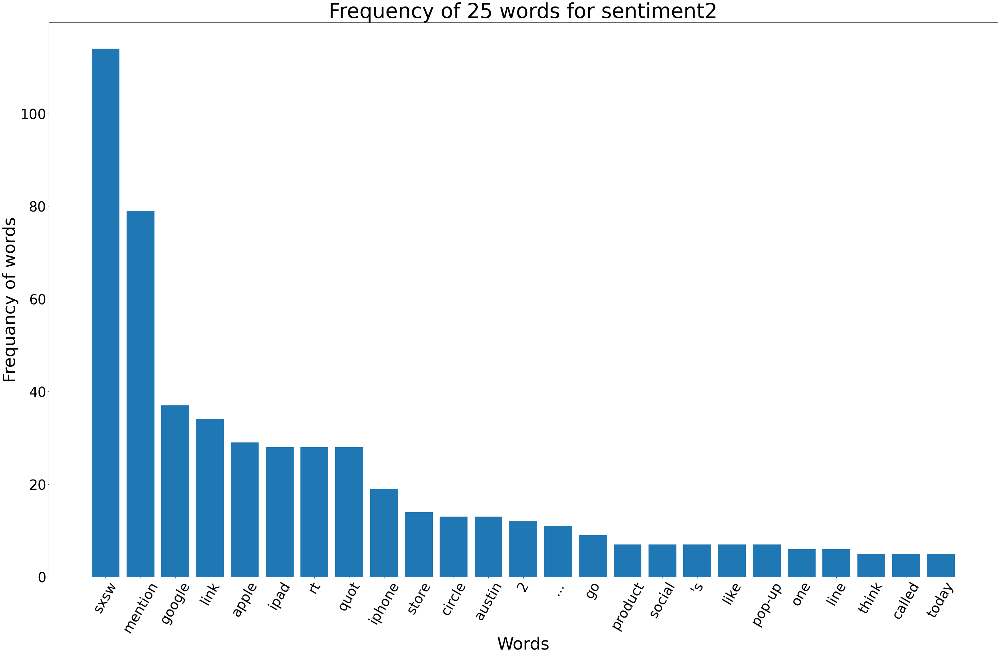

In [46]:
#for sentiment2
group_by_2=group_by.iloc[2]
word0=list(zip(*group_by_0))[0]
freq0=list(zip(*group_by_0))[1]

plt.figure(figsize=(50,30))
plt.bar(word0,freq0)
plt.xlabel('Words',fontsize=50)
plt.ylabel('Frequancy of words',fontsize=50)
plt.yticks(fontsize=40)
plt.xticks(rotation=60,fontsize=40)
plt.title('Frequency of 25 words for sentiment2',fontsize=60)
plt.show()

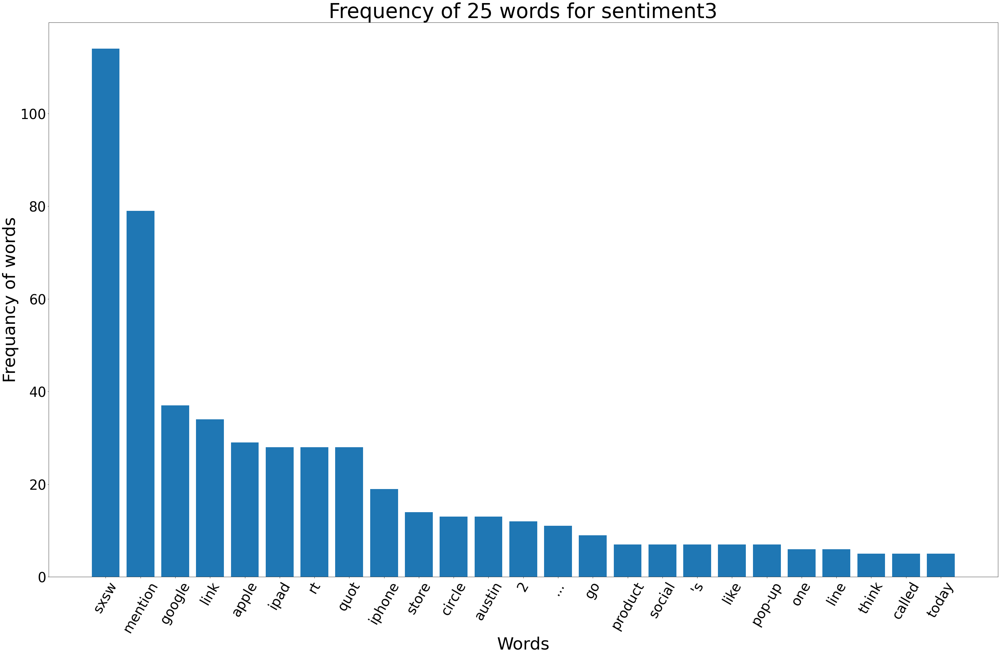

In [47]:
group_by_3=group_by.iloc[3]
word0=list(zip(*group_by_0))[0]
freq0=list(zip(*group_by_0))[1]

plt.figure(figsize=(50,30))
plt.bar(word0,freq0)
plt.xlabel('Words',fontsize=50)
plt.ylabel('Frequancy of words',fontsize=50)
plt.yticks(fontsize=40)
plt.xticks(rotation=60,fontsize=40)
plt.title('Frequency of 25 words for sentiment3',fontsize=60)
plt.show()

same 25 words are repeating for all the sentiments.there is no such words which shows positiveness. therefore we can't conclude anything from these words.it is better to remove them all.

# Topic Modeling

# Count Vectorizer

In [42]:
df2=df1[['Sentiment','Product_Type','sentiment_polarity']]
df2

,Sentiment,Product_Type,sentiment_polarity
0,2,9,0.000000e+00
1,2,9,3.000000e-01
2,2,9,-6.000000e-01
3,2,9,0.000000e+00
4,2,9,0.000000e+00
5,1,6,-5.000000e-01
6,2,9,0.000000e+00
7,3,9,3.333333e-02
8,2,9,5.656566e-02
9,2,9,6.000000e-01


In [43]:
#Count Vectorizer
tf_vectorizer = CountVectorizer(max_df=0.9,min_df=25,max_features=6000)
tf=tf_vectorizer.fit_transform(df1['lemmatized_str'].values.astype('U'))
tf_feature_names = tf_vectorizer.get_feature_names()

df3 = pd.DataFrame(tf.toarray(),columns=list(tf_feature_names))
df3

C:\Users\MANSI\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,03,10,11,12,1st,20,2011,30,40,...,work,working,world,would,wow,year,yes,yet,û_,ûï
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [44]:
d=[df2,df3]
data=pd.concat(d,axis=1)
data

,Sentiment,Product_Type,sentiment_polarity,00,03,10,11,12,1st,20,...,work,working,world,would,wow,year,yes,yet,û_,ûï
0,2,9,0.000000e+00,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2,9,3.000000e-01,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,9,-6.000000e-01,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2,9,0.000000e+00,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2,9,0.000000e+00,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,1,6,-5.000000e-01,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,2,9,0.000000e+00,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,3,9,3.333333e-02,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
8,2,9,5.656566e-02,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,2,9,6.000000e-01,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [45]:
#with sentiment polarity and product type
x=data.drop('Sentiment',axis=1)
y=data['Sentiment']

In [46]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=2)

# Model Building(Naive Bayes)

In [59]:
from sklearn.naive_bayes import GaussianNB
classifier = GaussianNB()
classifier.fit(x_train,y_train)

GaussianNB()

In [60]:
y_pred=classifier.predict(x_test)

In [61]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.02      0.26      0.05        39
           1       0.08      0.54      0.15       120
           2       0.79      0.19      0.31      1129
           3       0.43      0.32      0.36       622

    accuracy                           0.26      1910
   macro avg       0.33      0.33      0.22      1910
weighted avg       0.61      0.26      0.31      1910



In [ ]:
#without product type and sentiment polarity
# df2=df1['Sentiment']
# d=[df2,df3]
# data1=pd.concat(d,axis=1)
# data1

In [ ]:
# X=data1.drop('Sentiment',axis=1)
# Y=data1['Sentiment']

In [ ]:
# X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.3,random_state=3)

In [ ]:
# classifier.fit(X_train,Y_train)

In [ ]:
# Y_pred=classifier.predict(X_test)
# print(classification_report(Y_test,Y_pred))

In [49]:
from sklearn.metrics import classification_report

In [47]:
#Random Forest
from sklearn.ensemble import RandomForestClassifier
clf=RandomForestClassifier(n_estimators=100)
clf.fit(x_train,y_train)
y_pred=clf.predict(x_test)

In [50]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.25      0.03      0.05        39
           1       0.69      0.21      0.32       120
           2       0.91      0.98      0.94      1129
           3       0.84      0.89      0.87       622

    accuracy                           0.88      1910
   macro avg       0.67      0.53      0.54      1910
weighted avg       0.86      0.88      0.86      1910



In [92]:
#Random Forest
# from sklearn.ensemble import RandomForestClassifier
# clf=RandomForestClassifier(n_estimators=100)
# clf.fit(X_train,Y_train)
# Y_pred=clf.predict(X_test)

In [93]:
#Classification Report
# print(classification_report(Y_test,Y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        36
           1       0.29      0.08      0.12       125
           2       0.67      0.82      0.73      1129
           3       0.54      0.41      0.47       620

    accuracy                           0.62      1910
   macro avg       0.37      0.33      0.33      1910
weighted avg       0.59      0.62      0.59      1910



In [94]:
#Xgboost Classifier
# fit model no training data
# !pip install xgboost
# from xgboost import XGBClassifier
# model = XGBClassifier()
# model.fit(x_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, objective='multi:softprob',
              predictor='auto', ...)

In [95]:
# y_pred=model.predict(x_test)

In [97]:
 print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        39
           1       0.58      0.28      0.38       120
           2       0.91      0.98      0.94      1129
           3       0.85      0.87      0.86       622

    accuracy                           0.88      1910
   macro avg       0.59      0.53      0.55      1910
weighted avg       0.85      0.88      0.86      1910



In [52]:
#Pickle
from pickle import dump
from pickle import load
import pickle

In [53]:
pickle.dump(clf,open('rmmodel.pkl','wb'))

In [54]:
pickle.dump(tf_vectorizer,open('cv.pkl','wb'))

In [55]:
from sklearn.pipeline import Pipeline
pipeline = Pipeline([('cv',tf_vectorizer),('random',clf)])

In [56]:
import joblib
joblib.dump(pipeline,'sentiment_model.pkl')

['sentiment_model.pkl']